# Cell Instance Segmentation
---


In [2]:
# from google.colab import files
# files.upload()

# !pip install -q kaggle
# !mkdir ~/.kaggle
# !cp kaggle.json ~/.kaggle/
# !chmod 600 /root/.kaggle/kaggle.json
# !kaggle competitions download -c sartorius-cell-instance-segmentation
# !unzip sartorius-cell-instance-segmentation.zip

In [2]:
import os
import time
import random
import collections

import pandas as pd
import numpy as np

import colorsys
import cv2
import albumentations as A
from tqdm.auto import tqdm

import torch
import torchvision
from torchvision.transforms import functional as F
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor

from sklearn.model_selection import train_test_split

from PIL import Image
import matplotlib.pyplot as plt

In [4]:
train_df = pd.read_csv('/content/train.csv')
train_df['annotation']

0        118145 6 118849 7 119553 8 120257 8 120961 9 1...
1        189036 1 189739 3 190441 6 191144 7 191848 8 1...
2        173567 3 174270 5 174974 5 175678 6 176382 7 1...
3        196723 4 197427 6 198130 7 198834 8 199538 8 2...
4        167818 3 168522 5 169225 7 169928 8 170632 9 1...
                               ...                        
73580    3610 3 4311 7 5014 9 5717 11 6420 13 7123 15 7...
73581    341585 2 342287 5 342988 10 343690 13 344394 1...
73582    47788 3 48490 7 49192 11 49896 13 50599 14 513...
73583    333290 1 333993 2 334696 4 335399 5 336102 6 3...
73584    249775 2 250477 6 251180 8 251882 11 252585 12...
Name: annotation, Length: 73585, dtype: object

In [5]:
train_df.head().T

,0,1,2,3,4
id,0030fd0e6378,0030fd0e6378,0030fd0e6378,0030fd0e6378,0030fd0e6378
annotation,118145 6 118849 7 119553 8 120257 8 120961 9 1...,189036 1 189739 3 190441 6 191144 7 191848 8 1...,173567 3 174270 5 174974 5 175678 6 176382 7 1...,196723 4 197427 6 198130 7 198834 8 199538 8 2...,167818 3 168522 5 169225 7 169928 8 170632 9 1...
width,704,704,704,704,704
height,520,520,520,520,520
cell_type,shsy5y,shsy5y,shsy5y,shsy5y,shsy5y
plate_time,11h30m00s,11h30m00s,11h30m00s,11h30m00s,11h30m00s
sample_date,2019-06-16,2019-06-16,2019-06-16,2019-06-16,2019-06-16
sample_id,shsy5y[diff]_E10-4_Vessel-714_Ph_3,shsy5y[diff]_E10-4_Vessel-714_Ph_3,shsy5y[diff]_E10-4_Vessel-714_Ph_3,shsy5y[diff]_E10-4_Vessel-714_Ph_3,shsy5y[diff]_E10-4_Vessel-714_Ph_3
elapsed_timedelta,0 days 11:30:00,0 days 11:30:00,0 days 11:30:00,0 days 11:30:00,0 days 11:30:00


In [6]:
train_df['cell_type'].value_counts()

cell_type
shsy5y    52286
cort      10777
astro     10522
Name: count, dtype: int64

In [7]:
from datetime import datetime

In [8]:
train_df['plate_time'] = train_df['plate_time'].apply(lambda x: datetime.strptime(x, '%Hh%Mm%Ss'))
train_df['sample_date'] = train_df['sample_date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
train_df['elapsed_days'] = train_df['elapsed_timedelta'].apply(lambda x: x.split()[0])
train_df['elapsed_days'] = train_df['elapsed_timedelta'].apply(lambda x: datetime.strptime(x.split()[-1], '%H:%M:%S'))
train_df['elapsed_days'].value_counts()

elapsed_days
1900-01-01 11:30:00    52286
1900-01-01 09:00:00     6462
1900-01-01 13:30:00     5704
1900-01-01 13:00:00     4060
1900-01-01 19:30:00     2130
1900-01-01 11:59:00     1292
1900-01-01 07:30:00      923
1900-01-01 01:30:00      728
Name: count, dtype: int64

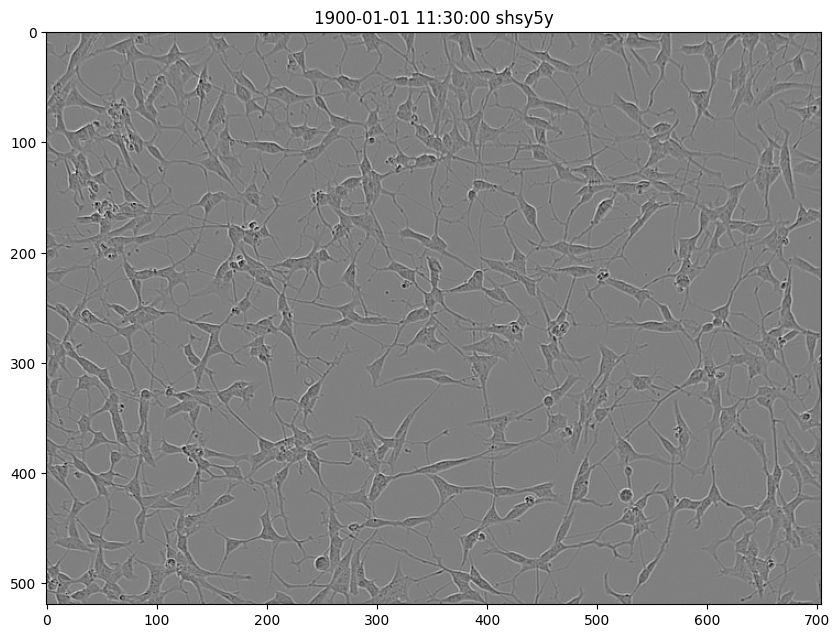

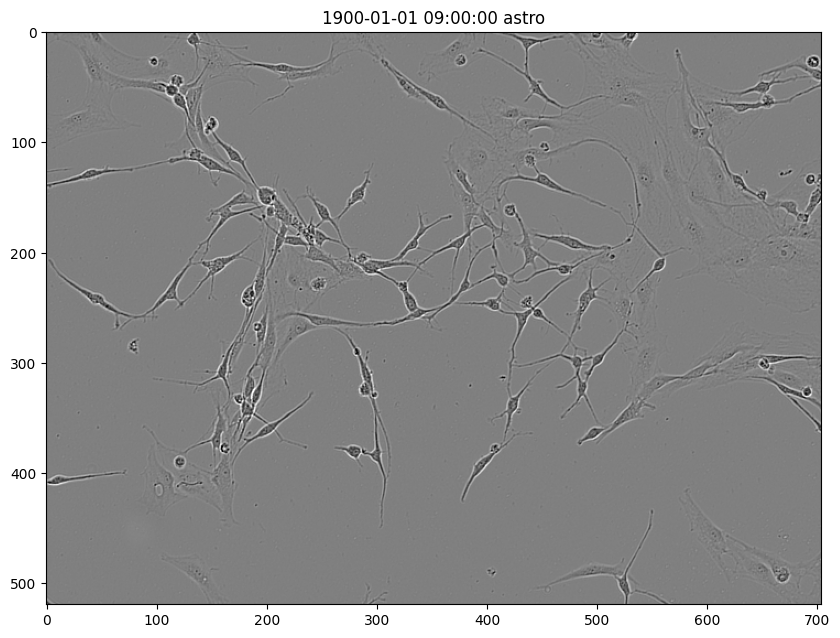

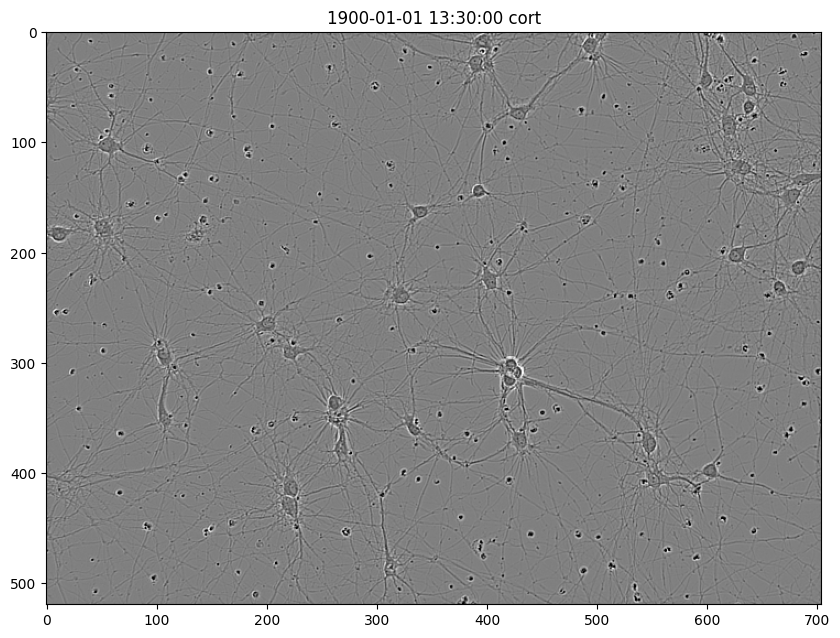

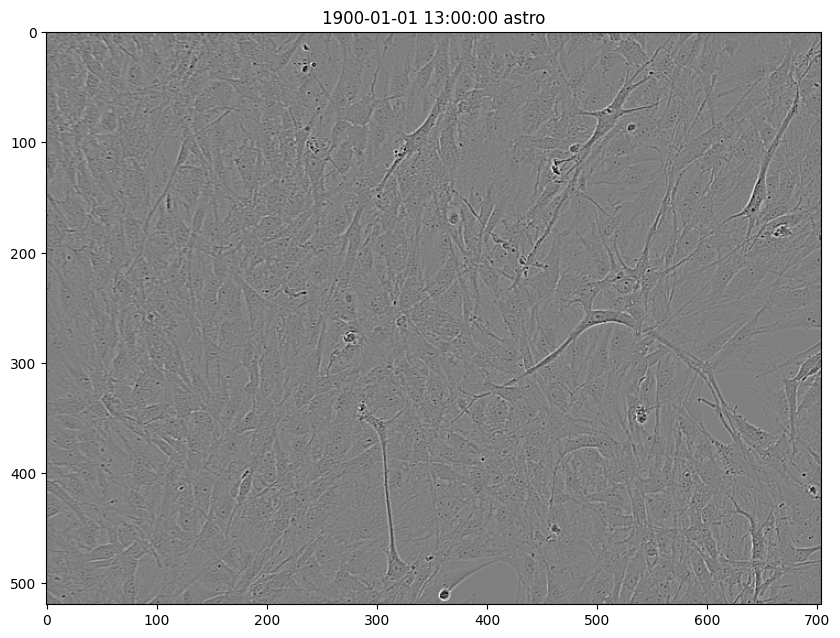

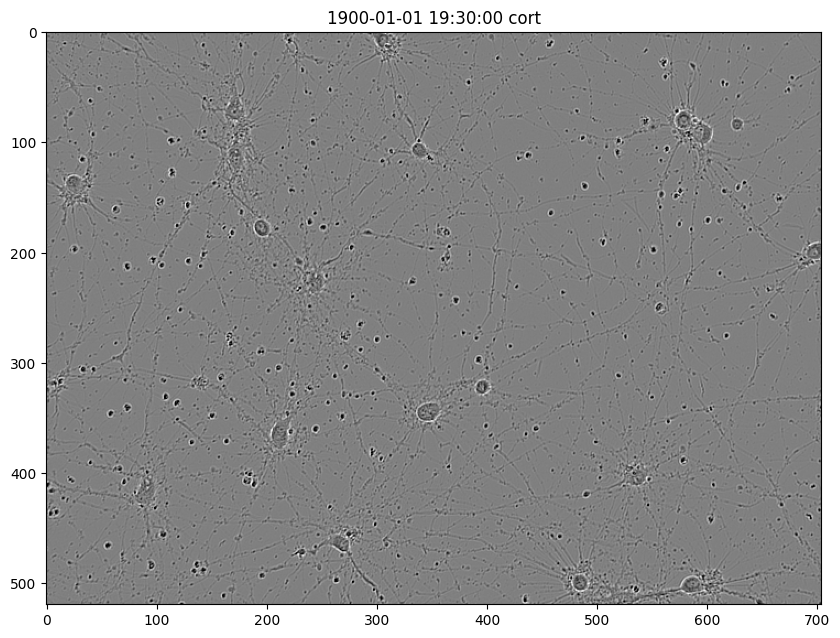

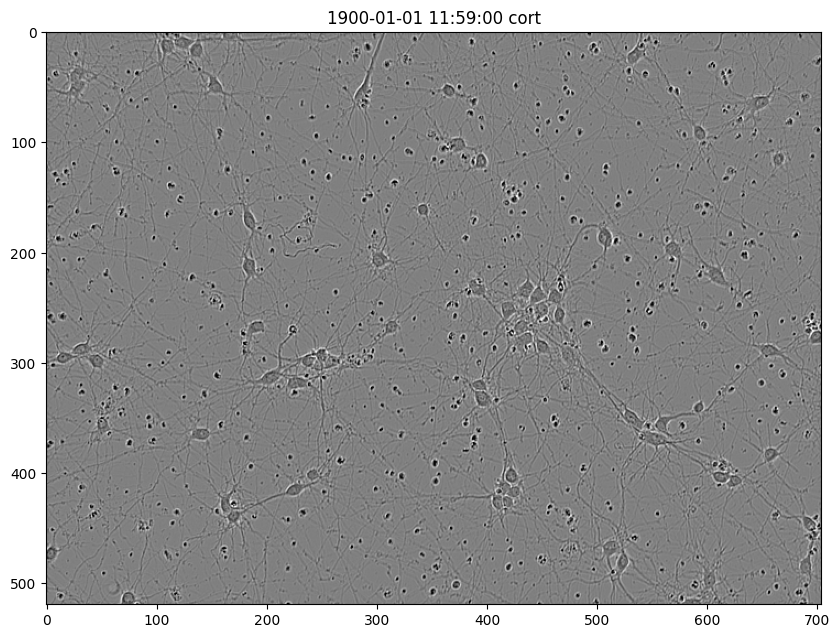

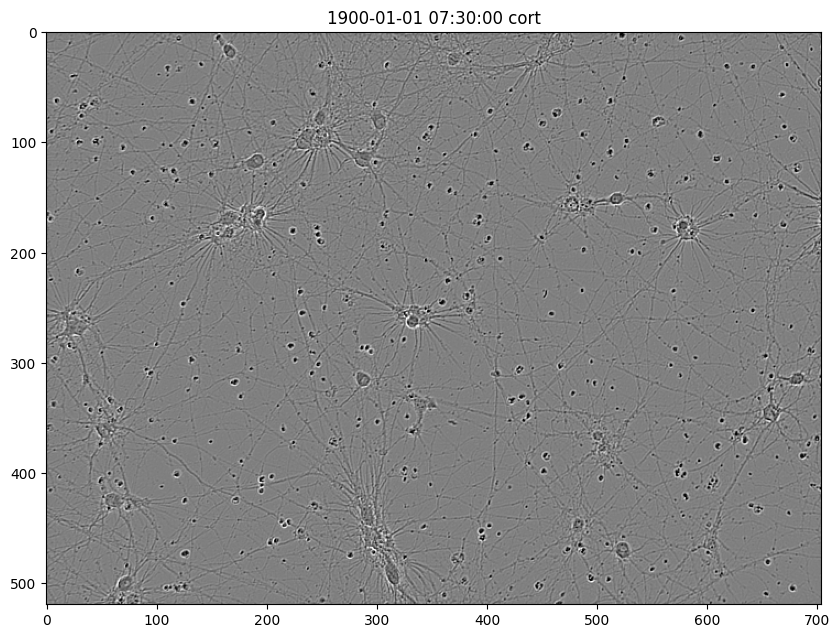

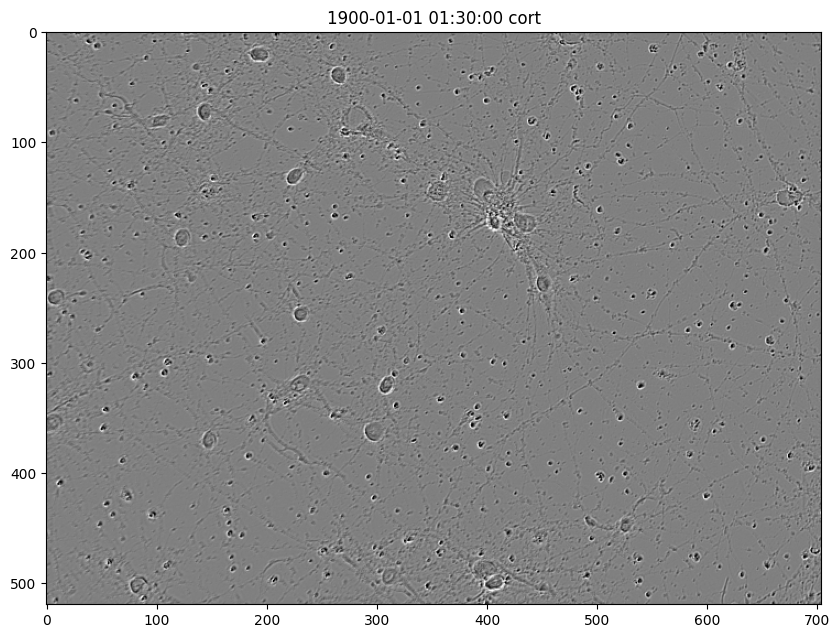

In [9]:
for plate_time in train_df['plate_time'].value_counts().index:
    values = train_df[train_df['plate_time'] == plate_time].sample(1).iloc[0]
    img_id = values['id']
    cell_type = values['cell_type']
    img = cv2.imread(f'/content/train/{img_id}.png')
    plt.figure(figsize=(10, 10))
    plt.title(f'{plate_time} {cell_type}')
    plt.imshow(img)
    plt.show()

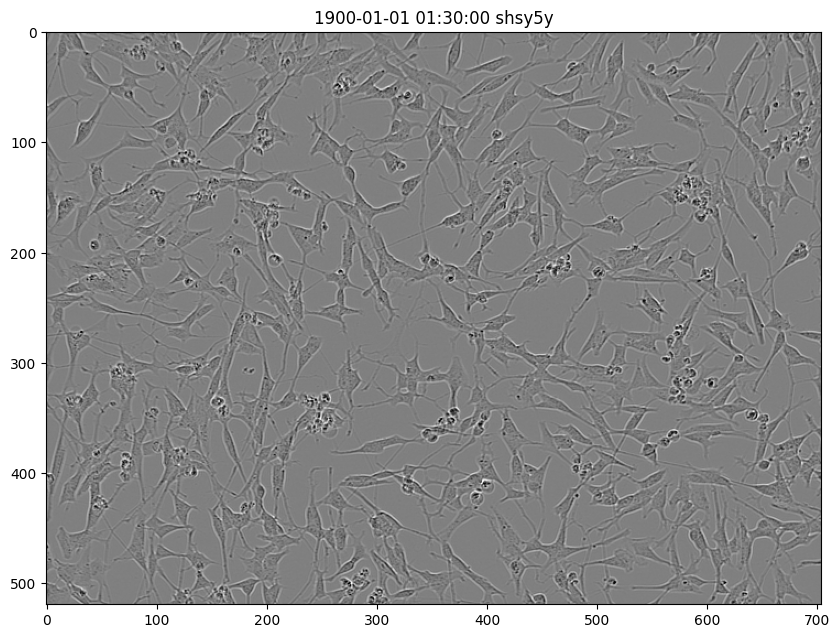

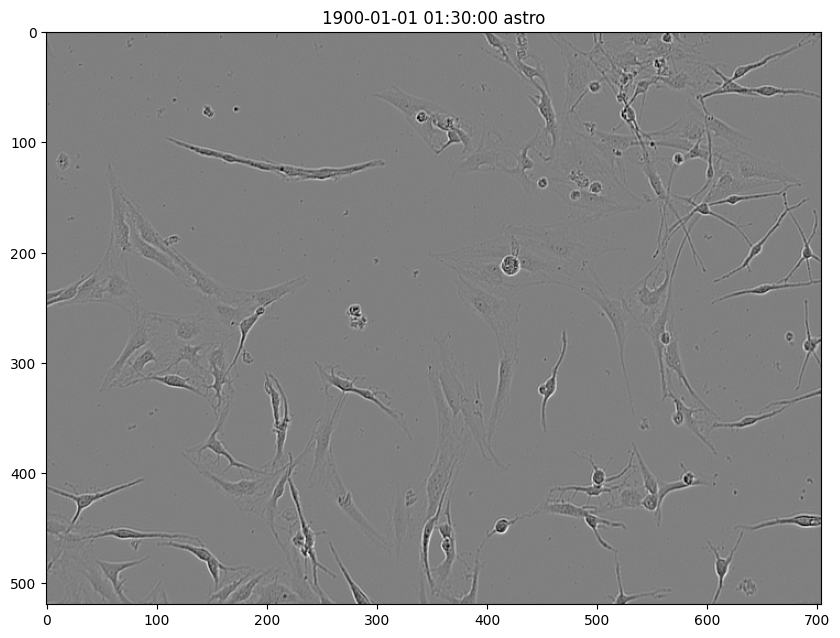

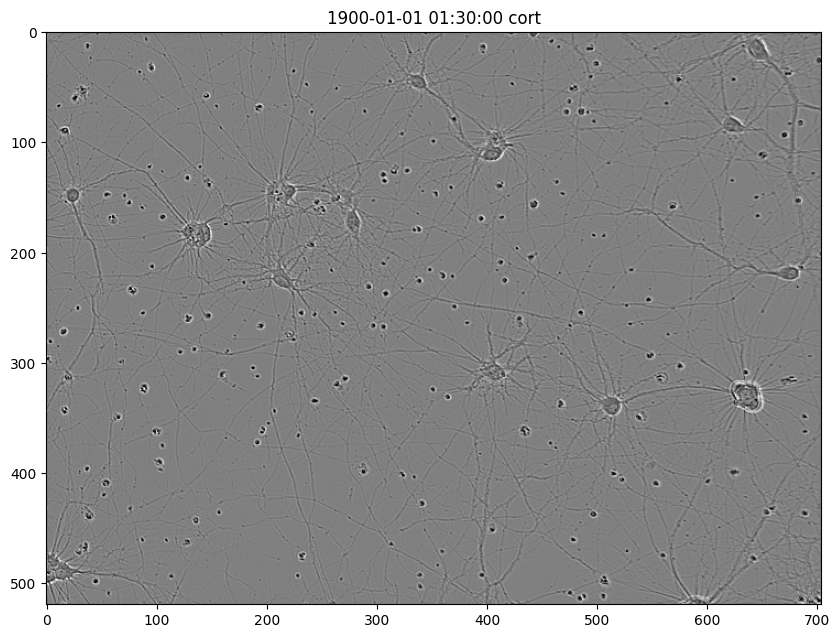

In [10]:
for cell_type in train_df['cell_type'].unique():
    values = train_df[train_df['cell_type'] == cell_type].sample(1).iloc[0]
    img_id = values['id']
    cell_type = values['cell_type']
    img = cv2.imread(f'/content/train/{img_id}.png')
    plt.figure(figsize=(10, 10))
    plt.title(f'{plate_time} {cell_type}')
    plt.imshow(img)
    plt.show()

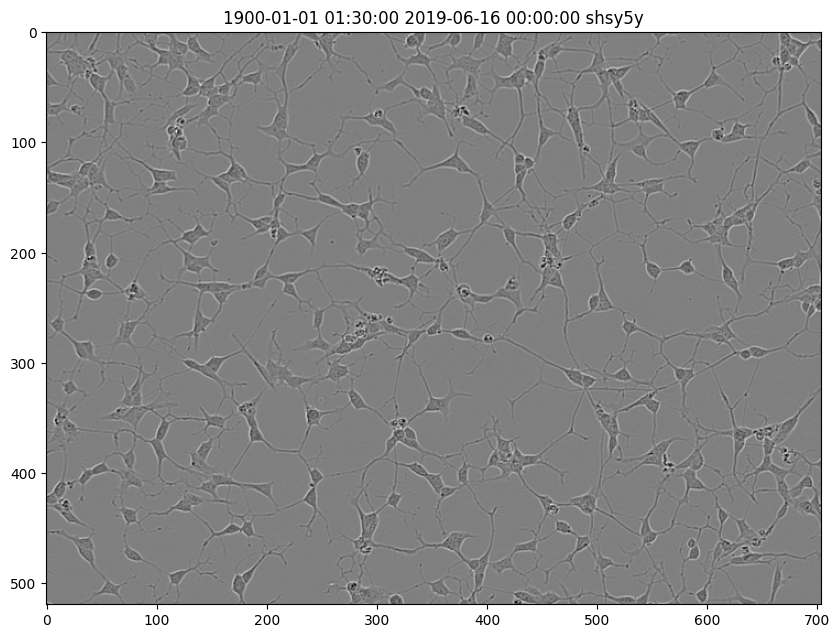

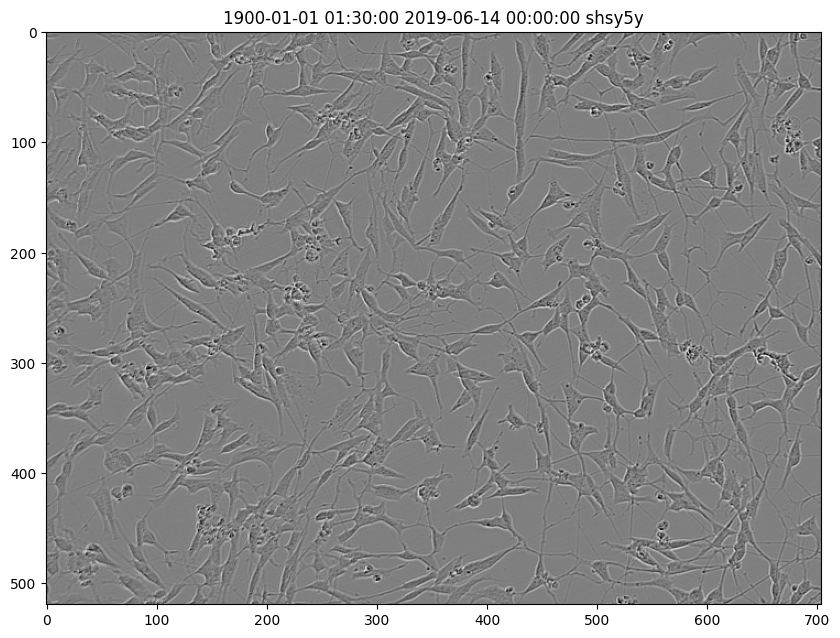

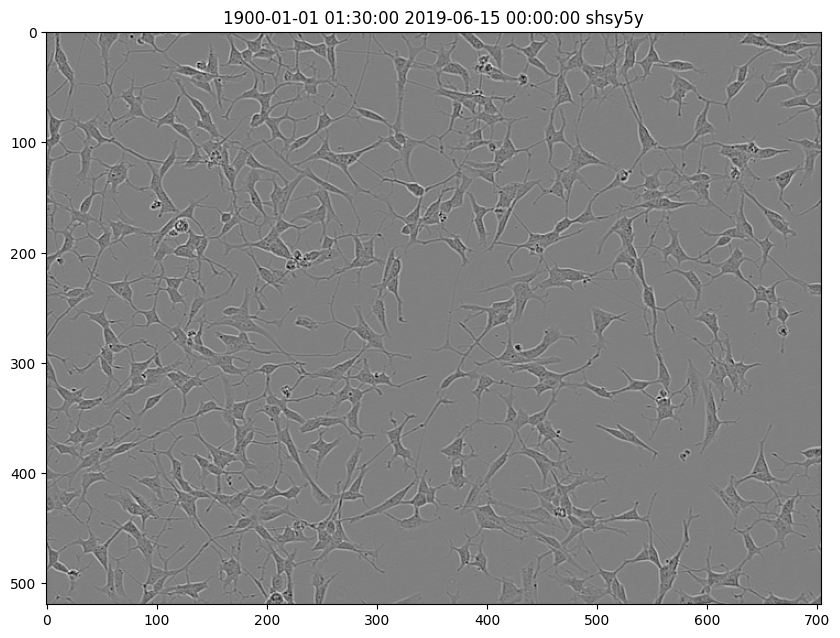

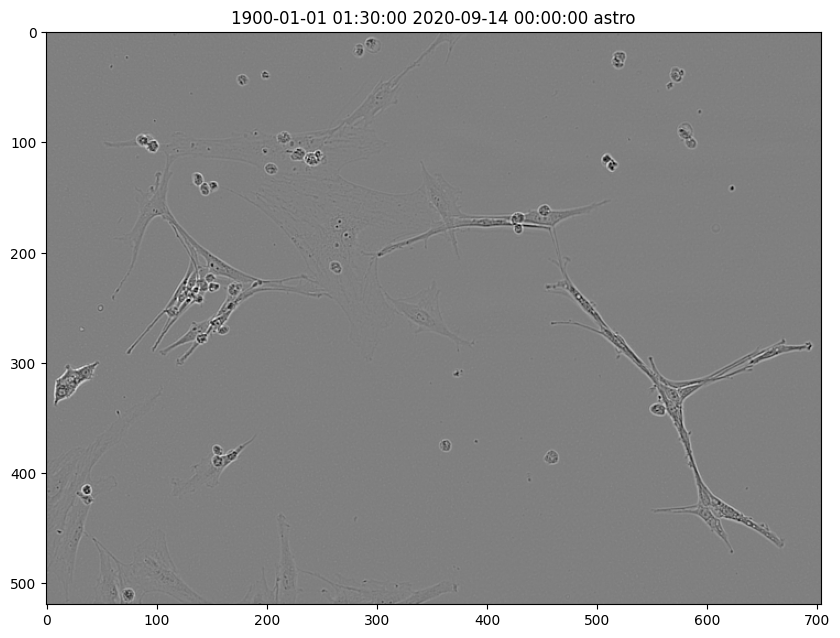

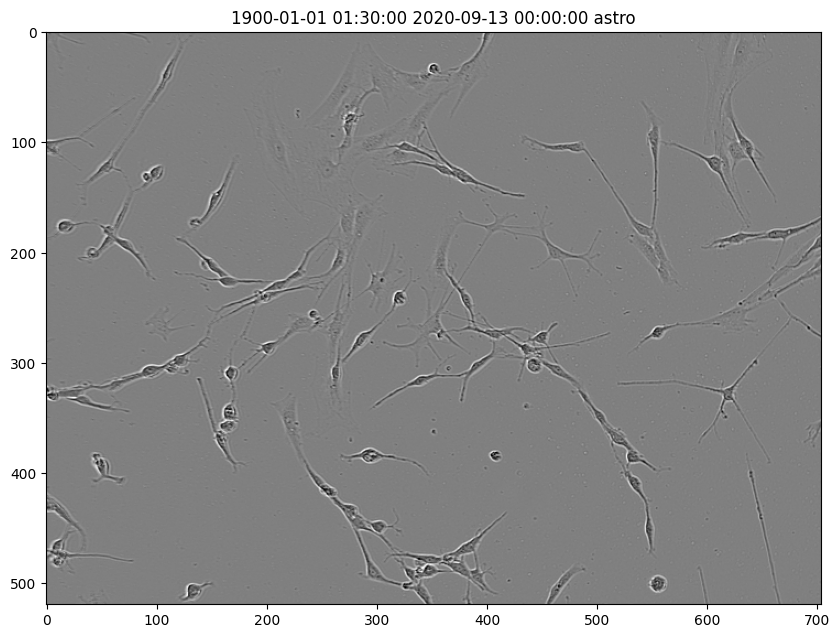

...

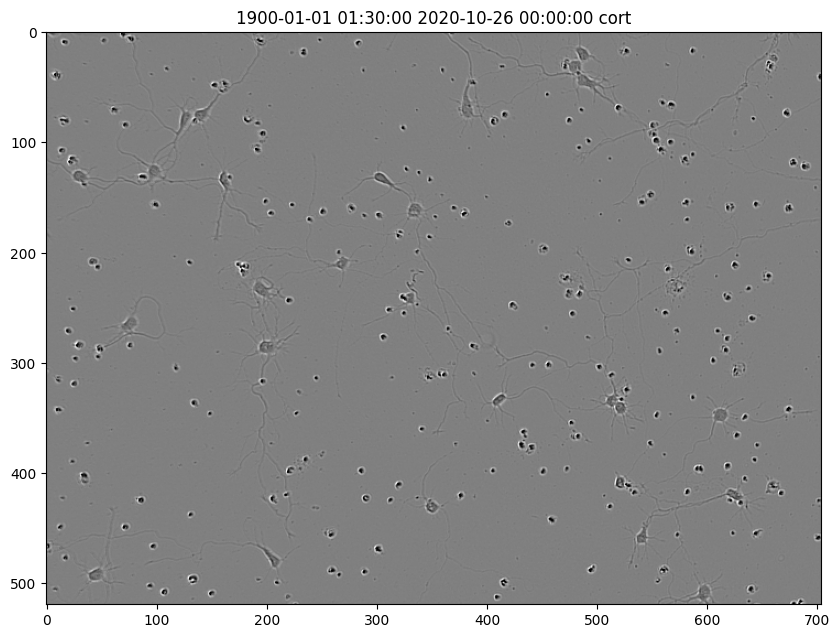

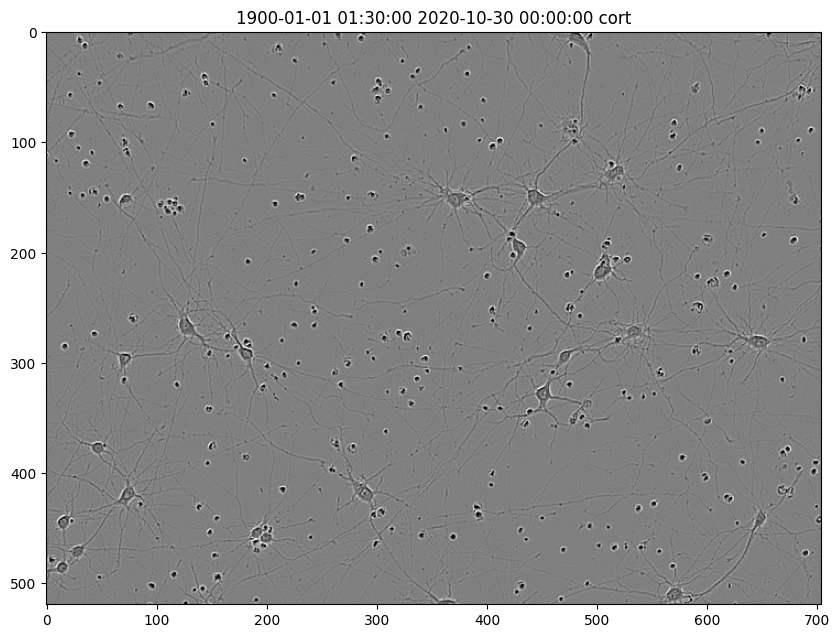

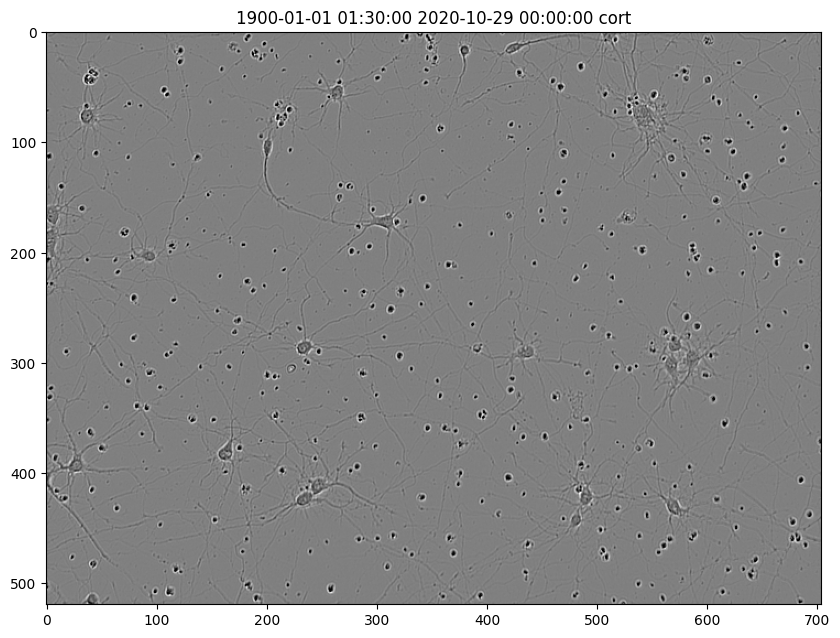

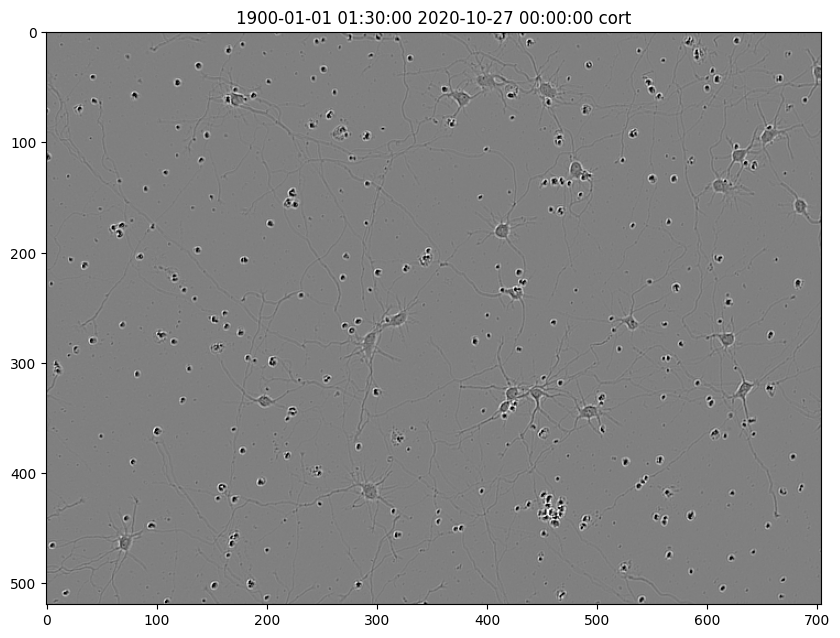

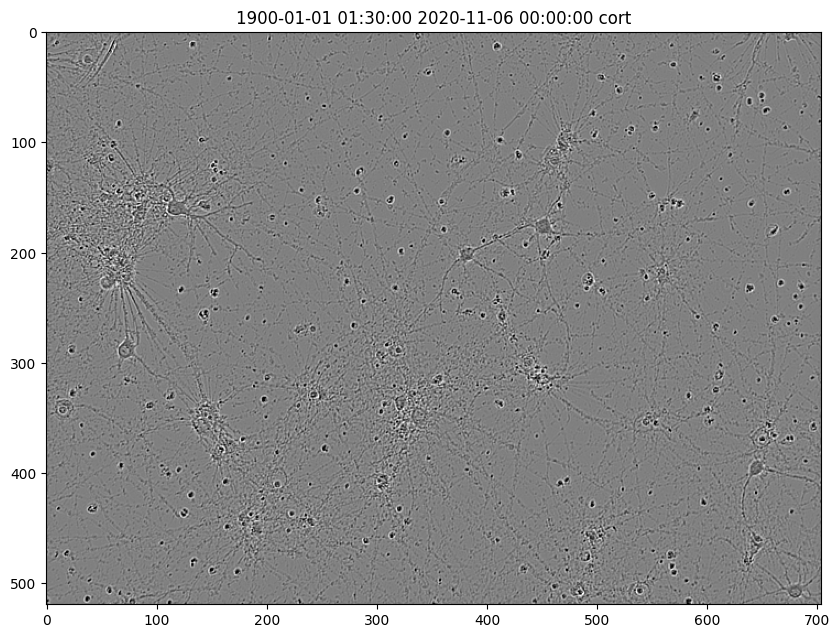

In [11]:
for cell_type in train_df['cell_type'].unique():
    for sample_date in train_df['sample_date'].value_counts().index:
        try:
            values = train_df[(train_df['sample_date'] == sample_date) & (train_df['cell_type'] == cell_type)].sample(1).iloc[0]
        except:
            continue
        img_id = values['id']
        sample_date = values['sample_date']
        img = cv2.imread(f'/content/train/{img_id}.png')
        plt.figure(figsize=(10, 10))
        plt.title(f'{plate_time} {sample_date} {cell_type}')
        plt.imshow(img)
        plt.show()

In [12]:
def random_colors(N, bright=True):
    """
    Generate random colors.
    To get visually distinct colors, generate them in HSV space then
    convert to RGB.
    """
    brightness = 1.0 if bright else 0.7
    hsv = [(i / N, 1, brightness) for i in range(N)]
    colors = list(map(lambda c: colorsys.hsv_to_rgb(*c), hsv))
    random.shuffle(colors)
    return colors

In [6]:
def decode_rle_mask(rle_mask, shape=(520, 704)):

    """
    Decode run-length encoded segmentation mask string into 2d array

    Parameters
    ----------
    rle_mask (str): Run-length encoded segmentation mask string
    shape (tuple): Height and width of the mask

    Returns
    -------
    mask [numpy.ndarray of shape (height, width)]: Decoded 2d segmentation mask
    """

    rle_mask = rle_mask.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (rle_mask[0:][::2], rle_mask[1:][::2])]
    starts -= 1
    ends = starts + lengths

    mask = np.zeros((shape[0] * shape[1]), dtype=np.uint8)
    for start, end in zip(starts, ends):
        mask[start:end] = 1

    mask = mask.reshape(shape[0], shape[1])
    mask = np.uint8(mask)
    return mask


def encode_rle_mask(mask, shape=(520, 704)):
    pixels = mask.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    rle = np.where(pixels[1:] != pixels[:-1])[0] + 1
    rle[1::2] -= rle[::2]
    return rle.tolist()

In [14]:
def visualize_image(df, image_id):

    """
    Visualize image along with segmentation masks

    Parameters
    ----------
    df [pandas.DataFrame of shape (73585, 9)]: Training dataframe
    image_id (str): Image ID (filename)
    """

    image_path = df.loc[df['id'] == image_id, 'id'].values[0]
    cell_type = df.loc[df['id'] == image_id, 'cell_type'].values[0]
    plate_time = df.loc[df['id'] == image_id, 'plate_time'].values[0]
    sample_date = df.loc[df['id'] == image_id, 'sample_date'].values[0]
    sample_id = df.loc[df['id'] == image_id, 'sample_id'].values[0]

    image = cv2.imread(f'/content/train/{image_path}.png')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    print(f'{image_id}\n{"-" * len(image_id)}')
    print(f'Image Mean: {np.mean(image):.4f}  -  Median: {np.median(image):.4f}  -  Std: {np.std(image):.4f} - Min: {np.min(image):.4f} -  Max: {np.max(image):.4f}')

    fig, axes = plt.subplots(figsize=(20, 20), ncols=2)
    fig.tight_layout(pad=5.0)

    axes[0].imshow(image, cmap='gray')
    masks = []
    for mask in df.loc[df['id'] == image_id, 'annotation'].values:
        decoded_mask = decode_rle_mask(rle_mask=mask, shape=image.shape)
        masks.append(decoded_mask)
    mask = np.stack(masks)
    mask = np.any(mask == 1, axis=0)
    axes[1].imshow(image, cmap='gray')
    axes[1].imshow(mask, alpha=0.4)

    for i in range(2):
        axes[i].set_xlabel('')
        axes[i].set_ylabel('')
        axes[i].tick_params(axis='x', labelsize=15, pad=10)
        axes[i].tick_params(axis='y', labelsize=15, pad=10)

    axes[0].set_title(f'{image_path} - {cell_type} - Annotations\n{plate_time} - {sample_date} - {sample_id}', fontsize=20, pad=15)
    axes[1].set_title('Segmentation Mask', fontsize=20, pad=15)
    plt.show()
    plt.close(fig)

e4632744011e
------------
Image Mean: 127.9351  -  Median: 128.0000  -  Std: 15.1100 - Min: 3.0000 -  Max: 255.0000


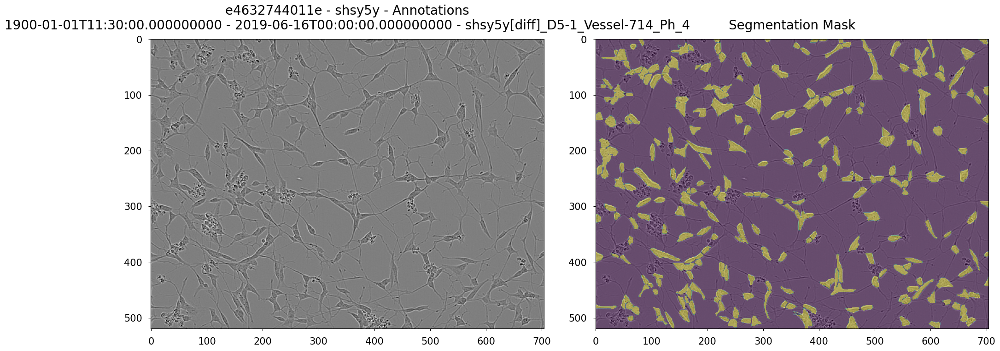

174793807517
------------
Image Mean: 127.9592  -  Median: 128.0000  -  Std: 10.6157 - Min: 3.0000 -  Max: 255.0000


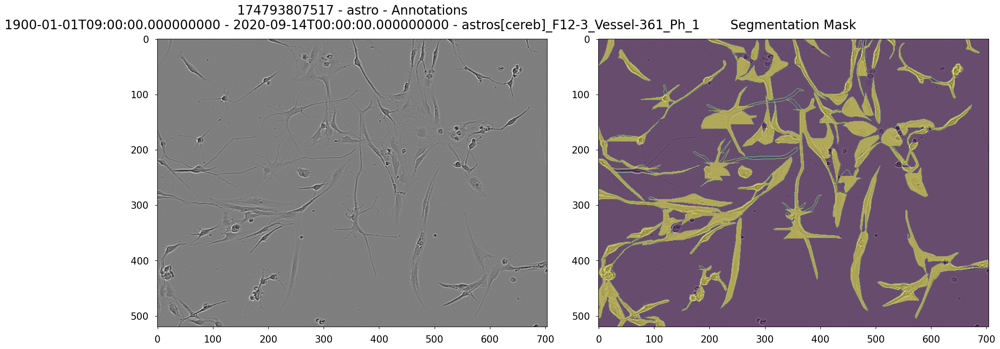

0f2a46026693
------------
Image Mean: 127.9610  -  Median: 128.0000  -  Std: 11.8595 - Min: 3.0000 -  Max: 255.0000


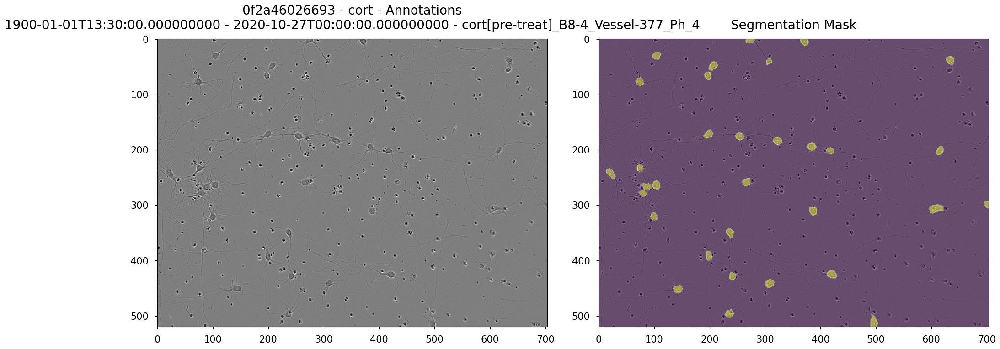

In [15]:
for cell_type in train_df['cell_type'].unique():
    values = train_df[train_df['cell_type'] == cell_type].sample(1).iloc[0]
    img_id = values['id']
    visualize_image(train_df, img_id)

In [16]:
def visualize(image, mask, original_image=None, original_mask=None, name_addtion=None):
    fontsize = 18

    if original_image is None and original_mask is None:
        f, ax = plt.subplots(2, 1, figsize=(8, 8))

        ax[0].imshow(image)
        ax[1].imshow(mask)
    else:
        f, ax = plt.subplots(2, 2, figsize=(10, 10))

        ax[0, 0].imshow(original_image)
        ax[0, 0].set_title('Original image', fontsize=fontsize)

        ax[1, 0].imshow(original_mask)
        ax[1, 0].set_title('Original mask', fontsize=fontsize)

        ax[0, 1].imshow(image)
        ax[0, 1].set_title('Transformed image', fontsize=fontsize)

        ax[1, 1].imshow(mask)
        ax[1, 1].set_title('Transformed mask', fontsize=fontsize)

(520, 704, 3) (520, 704)
(520, 704, 3) (520, 704)
(520, 704, 3) (520, 704)


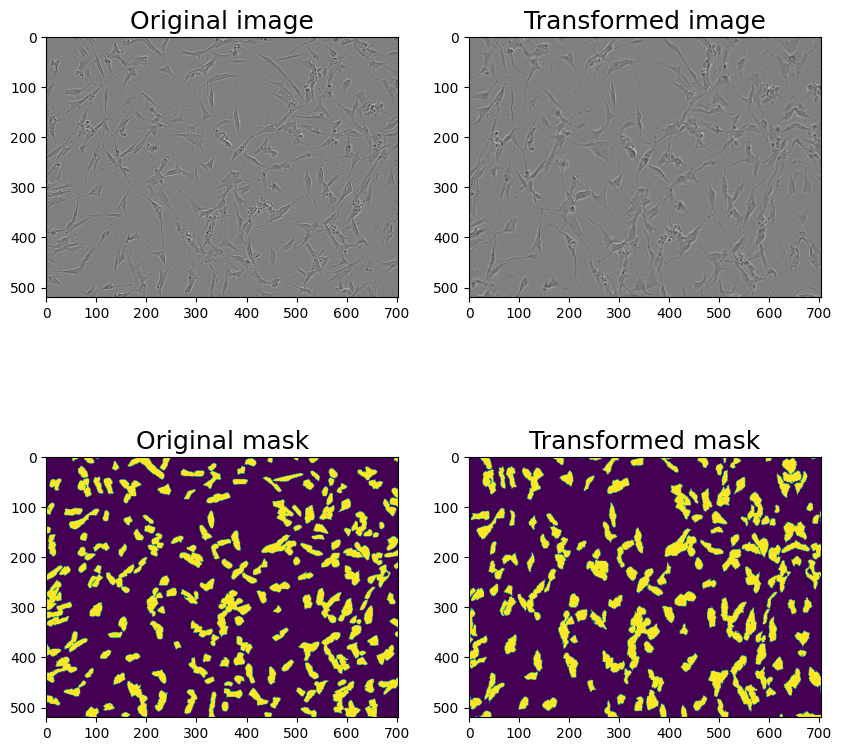

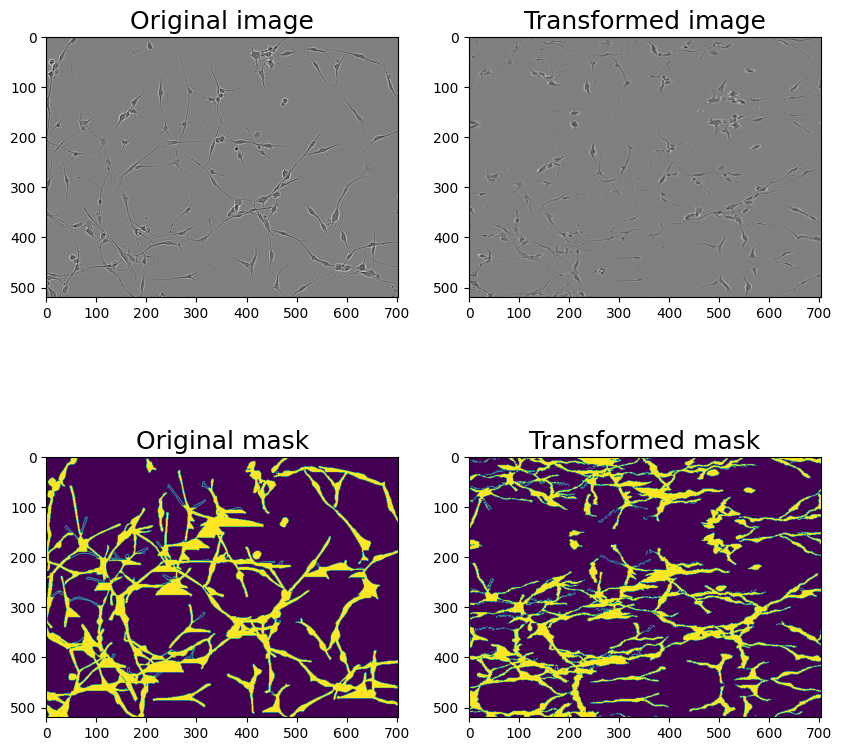

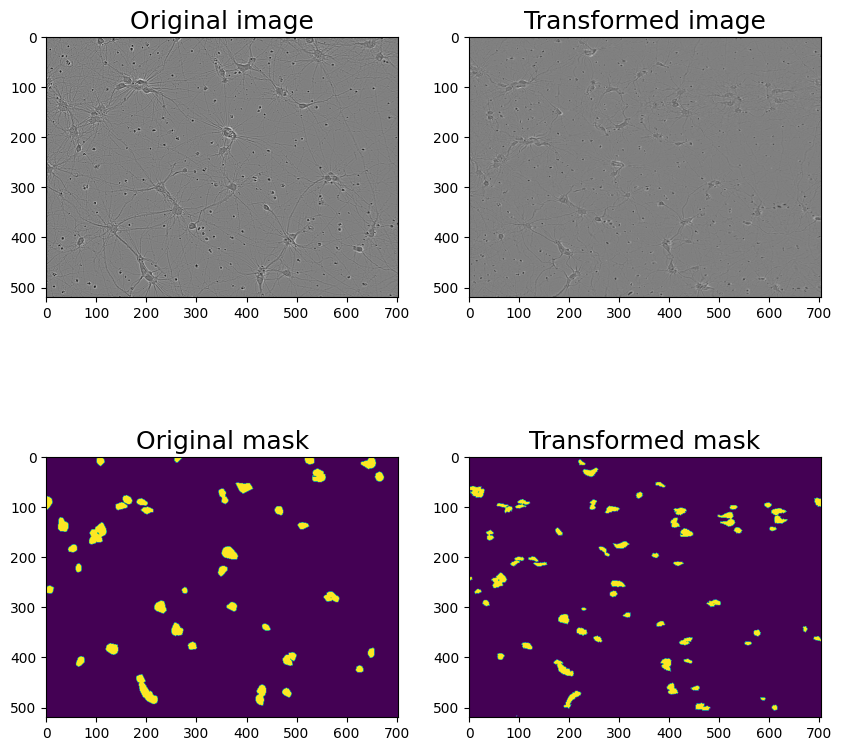

In [17]:
for cell_type in train_df['cell_type'].unique():
    print
    values = train_df[train_df['cell_type'] == cell_type].sample(1).iloc[0]
    img_id = values['id']
    image = cv2.imread(f'/content/train/{img_id}.png')
    # image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    masks = []
    for mask in train_df.loc[train_df['id'] == img_id, 'annotation'].values:
        decoded_mask = decode_rle_mask(rle_mask=mask, shape=image.shape)
        masks.append(decoded_mask)
    mask = np.stack(masks)
    mask = np.uint8(np.any(mask == 1, axis=0))

    aug = A.ElasticTransform(p=1, alpha=60, sigma=120 * 0.05, alpha_affine=120)

    augmented = aug(image=image, mask=mask)

    image_padded = augmented['image']
    mask_padded = augmented['mask']

    print(image_padded.shape, mask_padded.shape)

    visualize(image_padded, mask_padded, original_image=image, original_mask=mask)

In [18]:
def get_bboxes_from_mask(masks):
    coco_boxes = []
    for mask in masks:
        pos = np.nonzero(mask)
        xmin = np.min(pos[1])
        xmax = np.max(pos[1])
        ymin = np.min(pos[0])
        ymax = np.max(pos[0])
        coco_boxes.append([xmin, ymin, xmax, ymax])
    coco_boxes = np.asarray(coco_boxes)
    return coco_boxes

In [19]:
def get_targets_mask(df, img_id):
    targets = df[df['id'] == img_id]['cell_type'].apply(lambda x: cls_map[x]).values
    rles = df[df['id'] == img_id]['annotation'].values
    return targets, rles

In [20]:
cls_map = {value:idx for idx, value in enumerate(train_df['cell_type'].unique())}
cls_map_reversed = {cls_map[key]: key for key in cls_map.keys()}

In [42]:
img_id = train_df.iloc[0]['id']
img = cv2.imread(f'/content/train/{img_id}.png')

In [43]:
labels, rles = get_targets_mask(train_df, img_id)

In [45]:
mask = decode_rle_mask(str(encode_rle_mask(mask)).replace('[', '').replace(']', '').replace(',', ''))

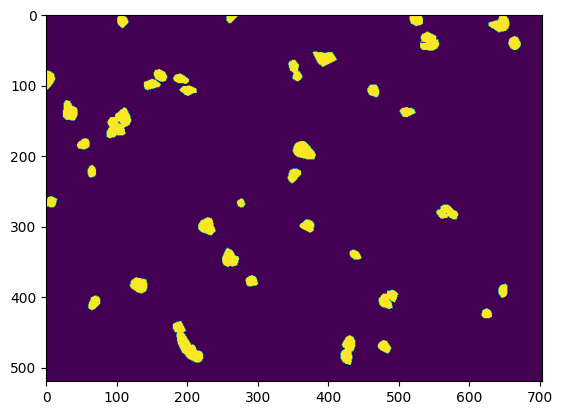

In [23]:
plt.imshow(mask)

In [24]:
masks = []
for mask in train_df.loc[train_df['id'] == img_id, 'annotation'].values:
    decoded_mask = decode_rle_mask(rle_mask=mask, shape=img.shape)
    masks.append(decoded_mask)

In [25]:
# masks = np.stack(masks)

In [26]:
bboxes = get_bboxes_from_mask(masks)

In [27]:
def apply_mask(image, mask, color, alpha=0.5):
    """Apply the given mask to the image.
    """
    for c in range(3):
        image[:, :, c] = np.where(mask == 1,
                                  image[:, :, c] *
                                  (1 - alpha) + alpha * color[c] * 255,
                                  image[:, :, c])
    return image

In [28]:
def plot_image_annotations(image, masks, bboxes, labels, aug=None):
    image = image.copy()

    colors = {unique_lbl:random_colors(1, True)[0] for unique_lbl in np.unique(labels)}

    if aug is not None:
        augmented = aug(image=image, masks=masks, bboxes=bboxes,
                        labels=labels)
        image = augmented['image']
        masks = augmented['masks']
        bboxes = augmented['bboxes']

    bboxes = np.stack(bboxes).astype(int)

    for idx, box in enumerate(bboxes):
        color = tuple([int(value*255) for value in colors[labels[idx]]])
        image = cv2.rectangle(image, (box[2], box[3]), (box[0], box[1]), color=color, thickness=2)

    for idx, mask in enumerate(masks):
        color = colors[labels[idx]]
        image = apply_mask(image, mask, color)

    plt.figure(figsize=(15, 15))
    plt.imshow(image)
    plt.show()

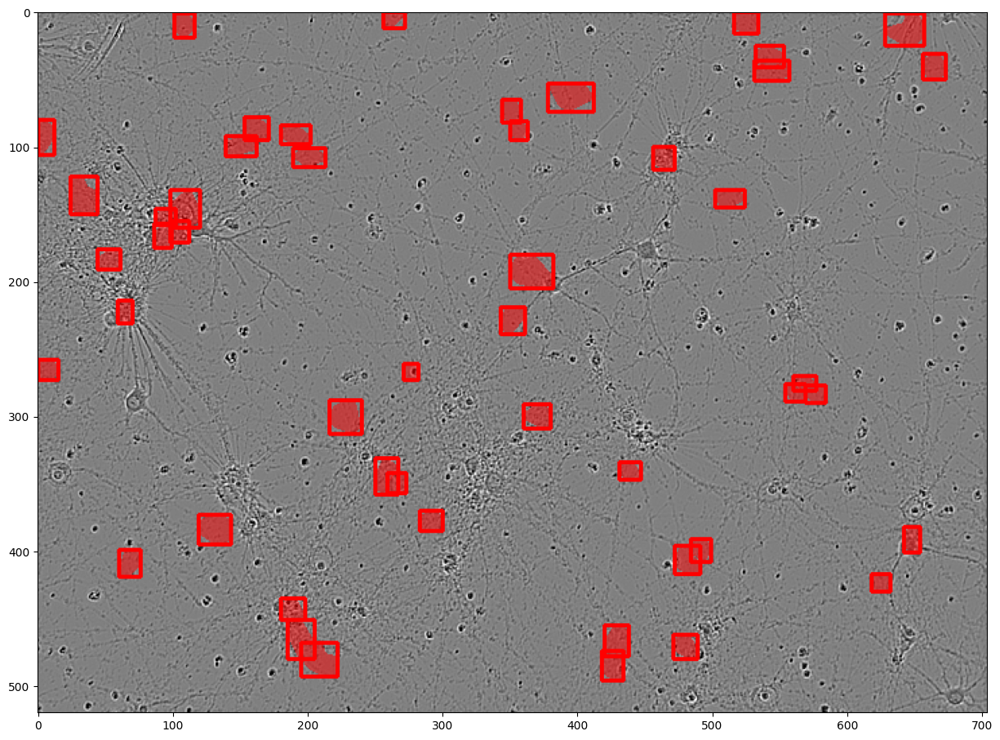

In [29]:
plot_image_annotations(image=img, masks=masks, bboxes=bboxes, labels=labels)

In [30]:
train_augmentations = A.Compose([
    A.RandomResizedCrop(640, 640, scale=(0.8, 1.0), ratio=(0.9, 1.3)),
    A.HorizontalFlip(),
    A.RandomRotate90()
], bbox_params={"format": "pascal_voc", "min_area": 0, "min_visibility": 0, 'label_fields': ['labels']})

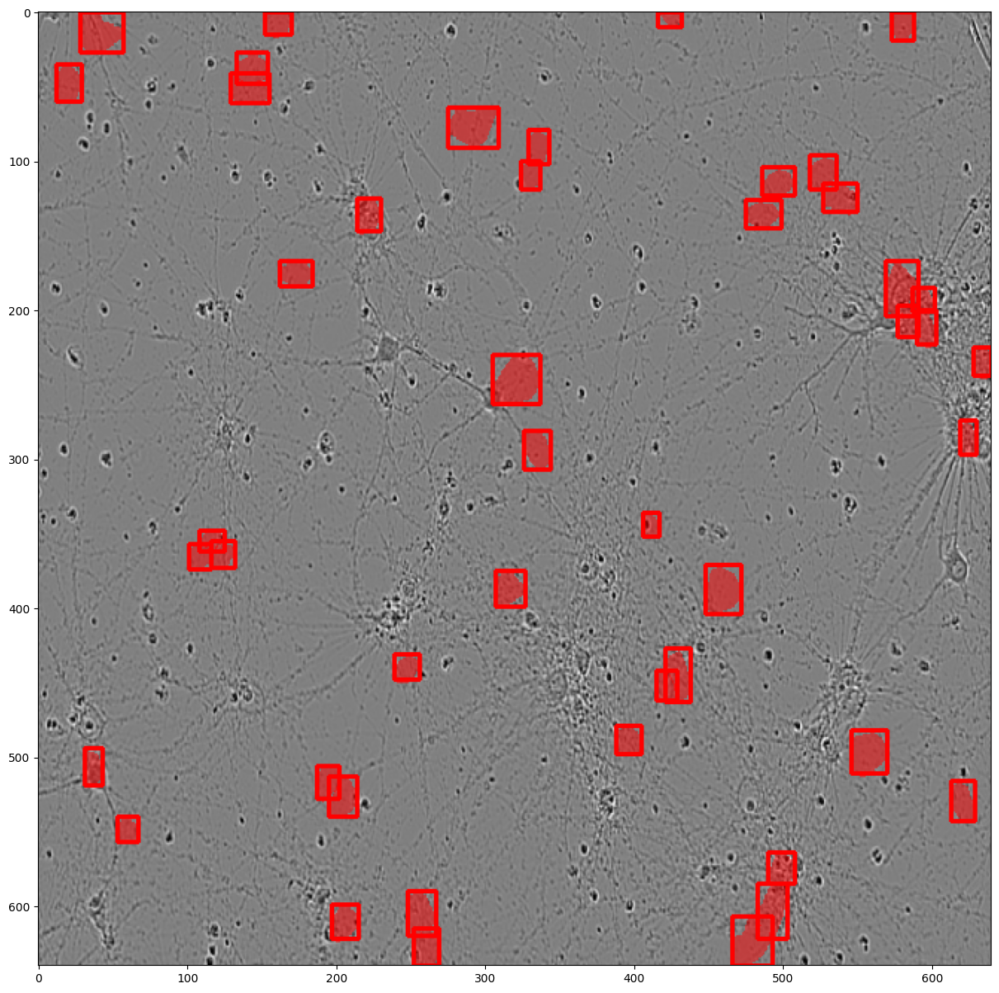

In [31]:
plot_image_annotations(image=img, masks=masks, bboxes=bboxes, labels=labels, aug=train_augmentations)

In [32]:
def rle_decode(mask_rle, shape, color=1):
    '''
    mask_rle: run-length as string formated (start length)
    shape: (height,width) of array to return
    Returns numpy array, 1 - mask, 0 - background
    '''
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0] * shape[1], dtype=np.float32)
    for lo, hi in zip(starts, ends):
        img[lo : hi] = color
    return img.reshape(shape)

In [33]:
WIDTH = 704
HEIGHT = 520

class CellDataset(torch.utils.data.Dataset):
    def __init__(self, image_dir, df, transforms=None, resize=False):
        self.transforms = transforms
        self.image_dir = image_dir
        self.df = df

        self.should_resize = resize is not False
        if self.should_resize:
            self.height = int(HEIGHT * resize)
            self.width = int(WIDTH * resize)
        else:
            self.height = HEIGHT
            self.width = WIDTH

        self.image_info = collections.defaultdict(dict)
        temp_df = self.df.groupby('id')['annotation'].agg(lambda x: list(x)).reset_index()
        for index, row in temp_df.iterrows():
            self.image_info[index] = {
                    'image_id': row['id'],
                    'image_path': os.path.join(self.image_dir, row['id'] + '.png'),
                    'annotations': row["annotation"]
                    }

    def get_box(self, a_mask):
        ''' Get the bounding box of a given mask '''
        pos = np.where(a_mask)
        xmin = np.min(pos[1])
        xmax = np.max(pos[1])
        ymin = np.min(pos[0])
        ymax = np.max(pos[0])
        return [xmin, ymin, xmax, ymax]

    def __getitem__(self, idx):
        ''' Get the image and the target'''

        img_path = self.image_info[idx]["image_path"]
        img = Image.open(img_path).convert("RGB")

        if self.should_resize:
            img = img.resize((self.width, self.height), resample=Image.BILINEAR)

        info = self.image_info[idx]

        n_objects = len(info['annotations'])
        masks = np.zeros((len(info['annotations']), self.height, self.width), dtype=np.uint8)
        boxes = []

        for i, annotation in enumerate(info['annotations']):
            a_mask = rle_decode(annotation, (HEIGHT, WIDTH))
            a_mask = Image.fromarray(a_mask)

            if self.should_resize:
                a_mask = a_mask.resize((self.width, self.height), resample=Image.BILINEAR)

            a_mask = np.array(a_mask) > 0
            masks[i, :, :] = a_mask

            boxes.append(self.get_box(a_mask))

        # dummy labels
        labels = [1 for _ in range(n_objects)]

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        masks = torch.as_tensor(masks, dtype=torch.uint8)

        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        iscrowd = torch.zeros((n_objects,), dtype=torch.int64)

        # This is the required target for the Mask R-CNN
        target = {
            'boxes': boxes,
            'labels': labels,
            'masks': masks,
            'image_id': image_id,
            'area': area,
            'iscrowd': iscrowd
        }

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self.image_info)

In [34]:
BOX_DETECTIONS_PER_IMG = 539
RESNET_MEAN = (0.485, 0.456, 0.406)
RESNET_STD = (0.229, 0.224, 0.225)
NORMALIZE = False

def get_model():
    # This is just a dummy value for the classification head
    NUM_CLASSES = 2

    if NORMALIZE:
        model = torchvision.models.detection.maskrcnn_resnet50_fpn_v2(
            weights='COCO_V1',
            box_detections_per_img=BOX_DETECTIONS_PER_IMG,
            image_mean=RESNET_MEAN,
            image_std=RESNET_STD
            )
    else:
        model = torchvision.models.detection.maskrcnn_resnet50_fpn(
            weights='COCO_V1',
            box_detections_per_img=BOX_DETECTIONS_PER_IMG
            )

    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, NUM_CLASSES)

    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask, hidden_layer, NUM_CLASSES)
    return model


# Get the Mask R-CNN model
# The model does classification, bounding boxes and MASKs for individuals, all at the same time
# We only care about MASKS
model = get_model()

# TODO: try removing this for
for param in model.parameters():
    param.requires_grad = True

model.train();

Downloading: "https://download.pytorch.org/models/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth" to /root/.cache/torch/hub/checkpoints/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth
100%|██████████| 170M/170M [00:01<00:00, 142MB/s]


In [35]:
# These are slight redefinitions of torch.transformation classes
# The difference is that they handle the target and the mask
class Compose:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, image, target):
        for t in self.transforms:
            image, target = t(image, target)
        return image, target

class VerticalFlip:
    def __init__(self, prob):
        self.prob = prob

    def __call__(self, image, target):
        if random.random() < self.prob:
            height, width = image.shape[-2:]
            image = image.flip(-2)
            bbox = target["boxes"]
            bbox[:, [1, 3]] = height - bbox[:, [3, 1]]
            target["boxes"] = bbox
            target["masks"] = target["masks"].flip(-2)
        return image, target

class HorizontalFlip:
    def __init__(self, prob):
        self.prob = prob

    def __call__(self, image, target):
        if random.random() < self.prob:
            height, width = image.shape[-2:]
            image = image.flip(-1)
            bbox = target["boxes"]
            bbox[:, [0, 2]] = width - bbox[:, [2, 0]]
            target["boxes"] = bbox
            target["masks"] = target["masks"].flip(-1)
        return image, target

class Normalize:
    def __call__(self, image, target):
        image = F.normalize(image, RESNET_MEAN, RESNET_STD)
        return image, target

class ToTensor:
    def __call__(self, image, target):
        image = F.to_tensor(image)
        return image, target


def get_transform(train):
    transforms = [ToTensor()]
    if NORMALIZE:
        transforms.append(Normalize())

    # Data augmentation for train
    if train:
        transforms.append(HorizontalFlip(0.5))
        transforms.append(VerticalFlip(0.5))

    return Compose(transforms)

In [36]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

ds_train = CellDataset('/content/train', train_df, resize=False, transforms=get_transform(train=True))

data_loader = torch.utils.data.DataLoader(
    ds_train, batch_size=4, shuffle=True, num_workers=os.cpu_count(),
    collate_fn=lambda x: tuple(zip(*x))
    )

# move model to the right device
model.to(device)
# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)
# and a learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=3,
                                               gamma=0.1)

# TODO: try removing this for
for param in model.parameters():
    param.requires_grad = True

model.train();

In [37]:
# let's train it for 10 epochs
NUM_EPOCHS = 10
n_batches = len(data_loader)
USE_SCHEDULER = False

for epoch in range(1, NUM_EPOCHS + 1):
    print(f"Starting epoch {epoch} of {NUM_EPOCHS}")

    time_start = time.time()
    loss_accum = 0.0
    loss_mask_accum = 0.0

    for batch_idx, (images, targets) in enumerate(data_loader, 1):

        # Predict
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        loss = sum(loss for loss in loss_dict.values())

        # Backprop
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Logging
        loss_mask = loss_dict['loss_mask'].item()
        loss_accum += loss.item()
        loss_mask_accum += loss_mask

        if batch_idx % 50 == 0:
            print(f"    [Batch {batch_idx:3d} / {n_batches:3d}] Batch train loss: {loss.item():7.3f}. Mask-only loss: {loss_mask:7.3f}")

    if USE_SCHEDULER:
        lr_scheduler.step()

    # Train losses
    train_loss = loss_accum / n_batches
    train_loss_mask = loss_mask_accum / n_batches


    elapsed = time.time() - time_start


    torch.save(model.state_dict(), f"pytorch_model-e{epoch}.bin")
    prefix = f"[Epoch {epoch:2d} / {NUM_EPOCHS:2d}]"
    print(f"{prefix} Train mask-only loss: {train_loss_mask:7.3f}")
    print(f"{prefix} Train loss: {train_loss:7.3f}. [{elapsed:.0f} secs]")

Starting epoch 1 of 10


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


    [Batch  50 / 152] Batch train loss:   1.780. Mask-only loss:   0.353
    [Batch 100 / 152] Batch train loss:   1.994. Mask-only loss:   0.327
    [Batch 150 / 152] Batch train loss:   1.355. Mask-only loss:   0.317
[Epoch  1 / 10] Train mask-only loss:   0.391
[Epoch  1 / 10] Train loss:   1.862. [302 secs]
Starting epoch 2 of 10
    [Batch  50 / 152] Batch train loss:   1.344. Mask-only loss:   0.299
    [Batch 100 / 152] Batch train loss:   1.685. Mask-only loss:   0.280
    [Batch 150 / 152] Batch train loss:   1.599. Mask-only loss:   0.309
[Epoch  2 / 10] Train mask-only loss:   0.326
[Epoch  2 / 10] Train loss:   1.571. [295 secs]
Starting epoch 3 of 10
    [Batch  50 / 152] Batch train loss:   1.404. Mask-only loss:   0.322
    [Batch 100 / 152] Batch train loss:   1.487. Mask-only loss:   0.331
    [Batch 150 / 152] Batch train loss:   1.655. Mask-only loss:   0.342
[Epoch  3 / 10] Train mask-only loss:   0.318
[Epoch  3 / 10] Train loss:   1.505. [292 secs]
Starting epoch 

In [38]:
class CellTestDataset(torch.utils.data.Dataset):
    def __init__(self, image_dir, transforms=None):
        self.transforms = transforms
        self.image_dir = image_dir
        self.image_ids = [f[:-4]for f in os.listdir(self.image_dir)]

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        image_path = os.path.join(self.image_dir, image_id + '.png')
        image = Image.open(image_path).convert("RGB")

        if self.transforms is not None:
            image, _ = self.transforms(image=image, target=None)
        return {'image': image, 'image_id': image_id}

    def __len__(self):
        return len(self.image_ids)

In [39]:
ds_test = CellTestDataset('/content/test', transforms=get_transform(train=False))

In [62]:
MIN_SCORE = 0.59
MASK_THRESHOLD = 0.5

def rle_encoding(x):
    dots = np.where(x.flatten() == 1)[0]
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
    return ' '.join(map(str, run_lengths))


def remove_overlapping_pixels(mask, other_masks):
    for other_mask in other_masks:
        if np.sum(np.logical_and(mask, other_mask)) > 0:
            mask[np.logical_and(mask, other_mask)] = 0
    return mask

model.eval();

submission = []
for sample in ds_test:
    img = sample['image']
    image_id = sample['image_id']
    with torch.no_grad():
        result = model([img.to(device)])[0]

    previous_masks = []
    for i, mask in enumerate(result["masks"]):

        # Filter-out low-scoring results. Not tried yet.
        score = result["scores"][i].cpu().item()
        if score < MIN_SCORE:
            continue

        mask = mask.cpu().numpy()
        # Keep only highly likely pixels
        binary_mask = mask > MASK_THRESHOLD
        binary_mask = remove_overlapping_pixels(binary_mask, previous_masks)
        previous_masks.append(binary_mask)
        rle = rle_encoding(binary_mask)
        submission.append((image_id, rle))

    # Add empty prediction if no RLE was generated for this image
    all_images_ids = [image_id for image_id, rle in submission]
    if image_id not in all_images_ids:
        submission.append((image_id, ""))

df_sub = pd.DataFrame(submission, columns=['id', 'predicted'])
df_sub.to_csv("submission.csv", index=False)
df_sub.head()

,id,predicted
0,7ae19de7bc2a,140003 16 140706 21 141410 22 142114 22 142818...
1,7ae19de7bc2a,1856 7 2559 9 3263 10 3967 11 4671 12 5375 12 ...
2,7ae19de7bc2a,354408 7 355111 9 355814 10 356517 12 357219 1...
3,7ae19de7bc2a,26627 15 27328 19 28030 21 28733 22 29436 23 3...
4,7ae19de7bc2a,179601 4 180304 6 181007 7 181711 7 182414 9 1...


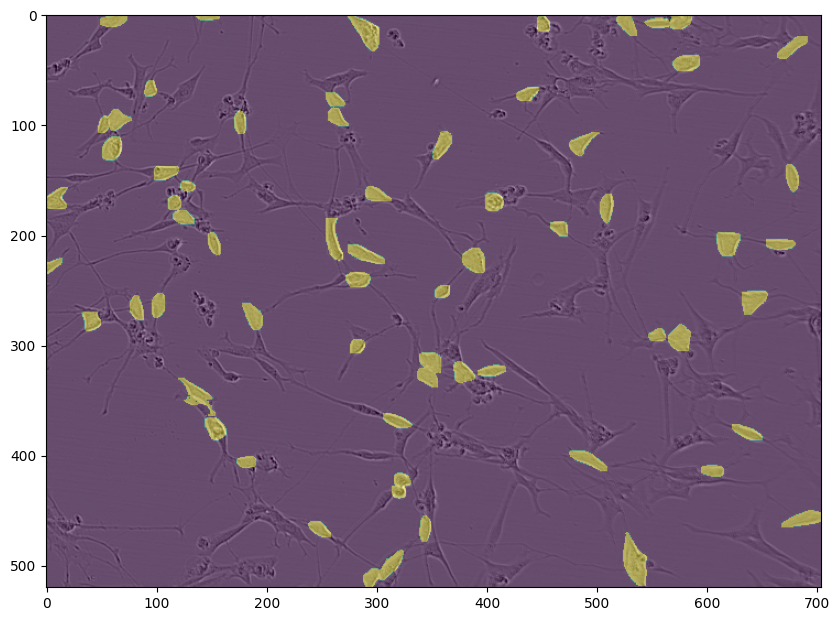

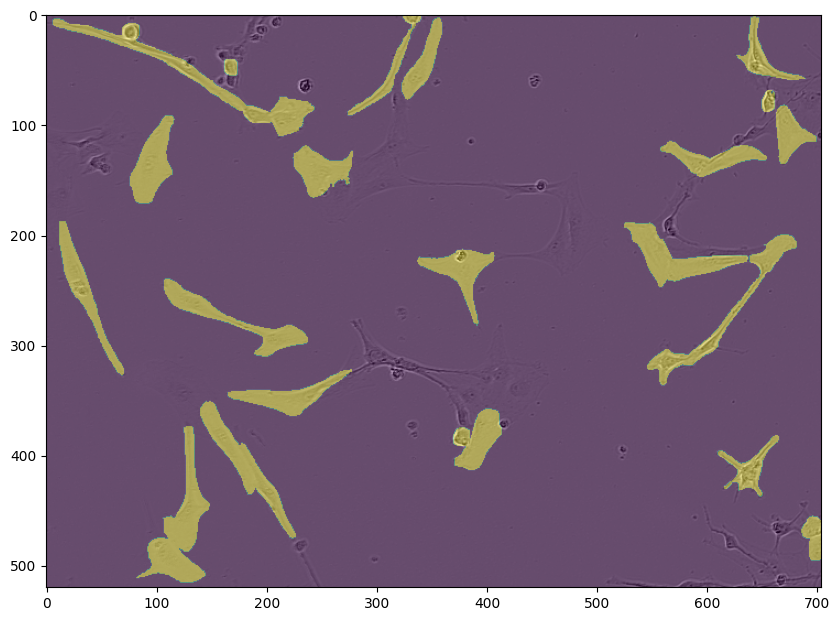

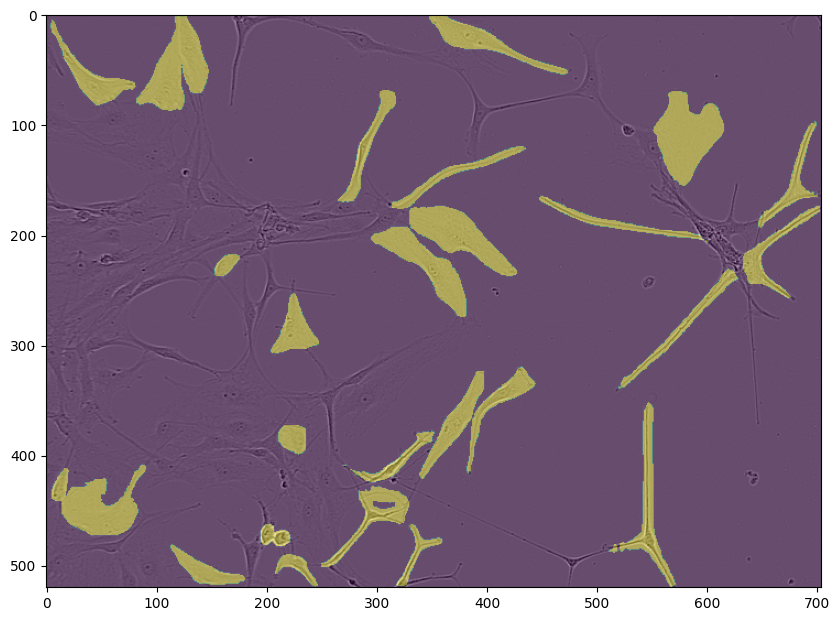

In [23]:
for image_name in os.listdir('test'):
    image = cv2.imread(f'test/{image_name}')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    image_id = image_name.split('.')[0]
    masks = []
    for mask in df_sub.loc[df_sub['id'] == image_id, 'predicted'].values:
        decoded_mask = decode_rle_mask(rle_mask=mask, shape=image.shape)
        masks.append(decoded_mask)
    mask = np.stack(masks)
    mask = np.any(mask == 1, axis=0)
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')
    plt.imshow(mask, alpha=0.4)
    plt.show()